## Tek Kanallı (T1) MRI Gri Görüntü ile Süperçözünürlük

In [10]:
%%capture
!pip install monai torch

In [11]:
%%capture
!pip install torchmetrics

In [12]:
import os
import glob #desene uyan bütün dosyaları bul, dosya avcısı
import torch
from monai.data import CacheDataset, DataLoader, decollate_batch
#cacheDataset: veriyi bir kere yükleyip RAM'e koyar.
#MRI dosyaları ağır, her epochta diskten okumak ise yavaş
#dataloader: veriyi parça parça (batch) modele veriri.
#deccolate_natch : model batch halinde çıktı verdi, tek tek sonuçları görmek için batch'i tek tek örneklere ayırır
from monai.transforms import ( #modele girmeden önce veri üzerinde dönüşüm
    Compose, #birden fazla işlemi sırayla uygular
    LoadImaged, #MRI dosyasını diskten yükler
    ScaleIntensityRanged, #görüntü parlaklığını belli aralığa sıkıştırır, farklı mr makinelerinden alınan görüntülerin normalizasyonu
    RandSpatialCropd, #MRI'nın rastgeler bir parçasını kesip alır
    EnsureChannelFirstd, #kanal boyutunu en başa al
    EnsureTyped, #veri pythorch tensor yapılır
    SpatialPadd,
                               MapTransform
)
import numpy as np

#cihaz ayarı, GPU varsa kullan, yoksa CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Kullanılan cihaz: {device}")

PATCH_SIZE_HR = 64
DS_FACTOR = 4
HR_KEY = "hr_img"
LR_KEY = "lr_img"

# HR/LR Çifti Oluşturan Transform
class CreateHRLR(MapTransform):
  #dataset dictionary ile çalışitığımız için maptransform kullandık
  def __init__(self, keys, ds_factor=4):
    super().__init__(keys) #keys: hangi veriye uyacak
    self.ds_factor = ds_factor

  def __call__(self,data):
    d = dict(data) #datanın orjinalini kopyaladık
    for key in self.keys:
      hr = d[key] #yüksek çözünürlüklü görüntü
      if not isinstance(hr, torch.Tensor):
        hr=torch.tensor(hr, dtype=torch.float32)
      lr=torch.nn.functional.interpolate(
          hr.unsqueeze(0).float(), #batch ekliyoruz
          scale_factor=1/self.ds_factor, #veriyi 0.25 ile çarpar, küçültür yani
          mode='trilinear',
          align_corners=False
      ).squeeze(0)
      d[HR_KEY] = hr
      d[LR_KEY] =lr
    return d

data_dicts = [{"img": "/content/drive/MyDrive/nifti_data/subject_001_qalas_4d.nii"}]

# Transfrom Pipeline
train_transforms = Compose([
    LoadImaged(keys=["img"]),
    EnsureChannelFirstd(keys=["img"]),
    ScaleIntensityRanged(keys=["img"], a_min=0.0, a_max=255.0, b_min=0.0, b_max=1.0, clip=True),
    SpatialPadd(keys=["img"], spatial_size=[PATCH_SIZE_HR]*3, method='symmetric'),
    RandSpatialCropd(keys=["img"], roi_size=[PATCH_SIZE_HR]*3, random_size=False),
    CreateHRLR(keys=["img"], ds_factor=DS_FACTOR),
    EnsureTyped(keys=[HR_KEY, LR_KEY])
])

# Dataset ve DataLoader
train_ds = CacheDataset(data=data_dicts, transform=train_transforms, cache_rate=1.0, num_workers=4)
train_loader = DataLoader(train_ds, batch_size=1, shuffle=True, num_workers=4)

print(f"Dataset Yüklendi. Toplam Örnek Sayısı: {len(data_dicts)}")
print(f"DataLoader Hazırlandı. Batch Boyutu: 1")

# Batch Kontrol
for batch_data in train_loader:
    lr_batch = batch_data[LR_KEY].to(device)
    hr_batch = batch_data[HR_KEY].to(device)
    print("\n--- ÇIKTI KONTROLÜ ---")
    print(f"LR Batch Shape: {lr_batch.shape}")
    print(f"HR Batch Shape: {hr_batch.shape}")
    break


Kullanılan cihaz: cuda


Loading dataset: 100%|██████████| 1/1 [00:00<00:00,  5.85it/s]

Dataset Yüklendi. Toplam Örnek Sayısı: 1
DataLoader Hazırlandı. Batch Boyutu: 1



--- ÇIKTI KONTROLÜ ---
LR Batch Shape: torch.Size([1, 5, 16, 16, 16])
HR Batch Shape: torch.Size([1, 5, 64, 64, 64])


## RESİDUAL GENERATOR + DISCRIMINATOR

In [13]:
import torch.nn as nn
from monai.networks.nets import UNet
import functools

IN_CHANNELS = 5 # Yeni giriş kanal sayısı
OUT_CHANNELS = 5 # Yeni çıkış kanal sayısı (tüm 5 haritayı tahmin ediyoruz)
SCALE_FACTOR = 4

# --- A) Generator (G) Mimarisi: Residual U-Net ---
# MONAI'de ResidualUNet yoksa, standart UNet'i Residual bloklarla özelleştirmemiz gerekir.
# En kolayı, Residual Modül eklenmiş U-Net'i temel almaktır.


class ResidualUNetGenerator(nn.Module):
    def __init__(self, in_channels, out_channels, scale_factor):
        super().__init__()
        # MONAI UNet'i, num_res_units argümanı ile Residual Bloklara benzer yapıya izin verir.
        self.unet = UNet(
            spatial_dims=3,
            in_channels=in_channels,
            out_channels=64,   # 🔥 ÖNEMLİ
            channels=(32, 64, 128, 256),
            strides=(2, 2, 2),
            num_res_units=2
        )

        self.upsample_layer = nn.ConvTranspose3d(
            in_channels=64,
            out_channels=out_channels,
            kernel_size=scale_factor,
            stride=scale_factor,
            padding=0
        )
        self.refine = nn.Sequential(
            nn.Conv3d(out_channels, out_channels, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv3d(out_channels, out_channels, 3, padding=1)
        )



    def forward(self, x):
        x_features = self.unet(x)
        sr = self.upsample_layer(x_features)
        sr = self.refine(sr)
        return sr


## Discriminator

Değeri yapay zeka mı üretti gerçek mi sorusunu sorar.

In [14]:
class Discriminator(nn.Module):
  def __init__(self, in_channels):
    super().__init__()
    self.net = nn.Sequential(
        nn.Conv3d(in_channels, 64, kernel_size=4, stride=2, padding=1 ), #64 farklı filtreyle giriş verisine bakıyor, downsampling görüntüyü küçültür
        #discriminator detay üretmez, gerçek mi diye sorar, o yüzden boyutu küçülterek özet çıkarır
        nn.LeakyReLU(0.2, inplace=True),
        #negatif değerleri tamamen öldürme
        nn.Conv3d(64,128, kernel_size=4, stride=2, padding=1),
        nn.BatchNorm3d(128),
        #katmanlar arası denge, değerler farklılaşmasın, eğitim stabil olsun
        nn.LeakyReLU(0.2, inplace=True),

        nn.Conv3d(128, 256, kernel_size=4, stride=2, padding=1), # 16 -> 8
        nn.BatchNorm3d(256),
        nn.LeakyReLU(0.2, inplace=True),

        nn.Conv3d(256, 512, kernel_size=4, stride=2, padding=1), # 8 -> 4
        nn.BatchNorm3d(512),
        nn.LeakyReLU(0.2, inplace=True),

        # Son katman: Çıktı 1 (Gerçek/Yapay Skoru)
        nn.Conv3d(512, 1, kernel_size=4, stride=1, padding=0) # 4 -> 1
    )

  def forward(self, x):
    return self.net(x)



In [15]:

# --- C) Perceptual Loss (VGG Loss) ---
# Gerçek MR verileri için önceden eğitilmiş VGG bulmak zordur.
# Bu nedenle, Perceptual Loss için Discriminator'ın ara katmanlarını kullanacağız (Feature-Loss).
class FeatureExtractor(nn.Module):
  def __init__(self, discriminator, feature_layer_idx):
    super().__init__()
    #discriminatorın ilk x katmanını feature extraction olarak ayarla
    self.feature_extractor = nn.Sequential(*list(discriminator.net.children())[:feature_layer_idx])
    #discriminator.net.childeen() : discriminator'ın içindeki katmanlar
    #ilk X tanesini al
    #feature_layer_idx=9 ise düşük+orta seviye özellikler
    #sequential: bunları yeni bir mini-model yap
  def forward(self, x):
    return self.feature_extractor(x)

#modeller tanımlandı
generator = ResidualUNetGenerator(IN_CHANNELS, OUT_CHANNELS, SCALE_FACTOR).to(device)
discriminator = Discriminator(OUT_CHANNELS).to(device)


# Loss ve Optimizasyonlar
criterion_pixel = nn.L1Loss() # Piksel Loss (L1)
criterion_gan = nn.BCEWithLogitsLoss() # Adversarial Loss (Binary Cross Entropy)
feature_extractor = FeatureExtractor(discriminator, 9).to(device) # Örn: 9. katmana kadar kullan
criterion_feature = nn.L1Loss() # Feature Loss (Perceptual Loss)

optimizer_G = torch.optim.Adam(generator.parameters(), lr=5e-5)
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=5e-5)

## SRGAN (SÜPER ÇÖZÜNÜRLÜKLÜ GAN) EĞİTİM DÖNGÜSÜ

In [19]:
# --------------------------------------------------------
# HÜCRE 2: SRGAN EĞİTİM DÖNGÜSÜ (NİCEL KAYIP ve DENGELEME)
# --------------------------------------------------------
from tqdm.notebook import tqdm # TQDM'in notebook versiyonunu kullan

# Loss ağırlıkları (Tuning edilmiş değerler)
lambda_pixel = 10.0
lambda_perceptual = 0.006
lambda_adversarial = 0.001
lambda_parametric = 1.0

# GAN Dengeleme Ayarları
D_STEPS = 2
num_epochs = 2500


# Nicel Kanal İndeksleri (Varsayım: Kanal 0=T1, Kanal 1=T2)
T1_CHANNEL_IDX = 0
T2_CHANNEL_IDX = 1

g_loss_history = []
d_loss_history = []

print(f"SRGAN Eğitimine Başlanıyor ({num_epochs} Epoch, D/G oranı 1/{D_STEPS})...")

for epoch in range(num_epochs):
    generator.train()
    discriminator.train()

    epoch_g_loss = 0.0
    epoch_d_loss = 0.0

    # DataLoader'dan Batch'leri Çekme
    for i, batch_data in enumerate(tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}")):
        hr_batch = batch_data[HR_KEY].to(device)
        lr_batch = batch_data[LR_KEY].to(device)

        # ---------------------------------
        # 1. DISCRIMINATOR EĞİTİMİ (D)
        # ---------------------------------
        if i % D_STEPS == 0:
            optimizer_D.zero_grad()

            # G'nin gradyanını keserek sahte HR üret (HATA DÜZELTME)
            with torch.no_grad():
                fake_hr_detached = generator(lr_batch).detach()

            # Gerçek (Hedef: 1)
            pred_real = discriminator(hr_batch)
            loss_D_real = criterion_gan(pred_real, torch.ones_like(pred_real))

            # Sahte (Hedef: 0)
            pred_fake = discriminator(fake_hr_detached)
            loss_D_fake = criterion_gan(pred_fake, torch.zeros_like(pred_fake))

            loss_D = loss_D_real + loss_D_fake
            loss_D.backward()
            optimizer_D.step()

            epoch_d_loss += loss_D.item()

        # ---------------------------------
        # 2. GENERATOR EĞİTİMİ (G)
        # ---------------------------------
        optimizer_G.zero_grad()
        fake_hr = generator(lr_batch) # G'yi tekrar çalıştır (grafiği koru)

        # i) Piksel Loss (L1)
        loss_pixel = criterion_pixel(fake_hr, hr_batch)

        # ii) Perceptual Loss (Feature Loss)
        real_features = feature_extractor(hr_batch)
        fake_features = feature_extractor(fake_hr)
        loss_perceptual = criterion_feature(fake_features, real_features)

        # iii) Adversarial Loss (GAN)
        pred_fake = discriminator(fake_hr)
        loss_adversarial = criterion_gan(pred_fake, torch.ones_like(pred_fake))

        # iv) Nicel (Parametrik) Kayıp (T1 ve T2 kanalları)
        fake_t1 = fake_hr[:, T1_CHANNEL_IDX:T1_CHANNEL_IDX+1, ...]
        real_t1 = hr_batch[:, T1_CHANNEL_IDX:T1_CHANNEL_IDX+1, ...]
        fake_t2 = fake_hr[:, T2_CHANNEL_IDX:T2_CHANNEL_IDX+1, ...]
        real_t2 = hr_batch[:, T2_CHANNEL_IDX:T2_CHANNEL_IDX+1, ...]

        loss_parametric = criterion_pixel(fake_t1, real_t1) + criterion_pixel(fake_t2, real_t2)

        # Toplam Generator Loss
        loss_G = (lambda_pixel * loss_pixel) + \
                 (lambda_perceptual * loss_perceptual) + \
                 (lambda_adversarial * loss_adversarial) + \
                 (lambda_parametric * loss_parametric)

        loss_G.backward()
        optimizer_G.step()

        epoch_g_loss += loss_G.item()

    # Epoch Sonu Raporlama ve Kayıt
    avg_g_loss = epoch_g_loss / len(train_loader)
    # D, G'den daha az güncellendiği için doğru bölme yapılır
    avg_d_loss = epoch_d_loss / (len(train_loader) / D_STEPS)
    g_loss_history.append(avg_g_loss)
    d_loss_history.append(avg_d_loss)

    if (epoch + 1) % 10 == 0 or epoch == num_epochs - 1:
        print(f"Epoch [{epoch+1}/{num_epochs}], G_Loss: {avg_g_loss:.6f}, D_Loss: {avg_d_loss:.6f}")

print("SRGAN Eğitim Testi Başarıyla Tamamlandı.")

SRGAN Eğitimine Başlanıyor (2500 Epoch, D/G oranı 1/2)...


Epoch 1/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 3/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 4/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 5/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 6/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 7/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 8/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 9/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 10/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [10/2500], G_Loss: 1.352789, D_Loss: 0.000758


Epoch 11/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 12/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 13/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 14/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 15/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 16/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 17/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 18/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 19/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 20/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [20/2500], G_Loss: 1.330913, D_Loss: 0.000912


Epoch 21/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 22/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 23/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 24/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 25/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 26/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 27/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 28/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 29/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 30/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [30/2500], G_Loss: 1.721210, D_Loss: 0.000135


Epoch 31/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 32/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 33/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 34/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 35/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 36/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 37/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 38/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 39/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 40/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [40/2500], G_Loss: 1.206820, D_Loss: 0.000043


Epoch 41/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 42/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 43/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 44/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 45/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 46/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 47/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 48/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 49/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 50/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [50/2500], G_Loss: 1.043585, D_Loss: 0.000573


Epoch 51/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 52/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 53/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 54/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 55/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 56/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 57/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 58/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 59/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 60/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [60/2500], G_Loss: 1.236274, D_Loss: 0.000833


Epoch 61/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 62/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 63/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 64/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 65/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 66/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 67/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 68/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 69/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 70/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [70/2500], G_Loss: 1.000029, D_Loss: 0.000588


Epoch 71/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 72/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 73/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 74/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 75/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 76/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 77/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 78/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 79/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 80/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [80/2500], G_Loss: 1.875371, D_Loss: 0.000212


Epoch 81/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 82/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 83/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 84/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 85/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 86/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 87/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 88/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 89/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 90/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [90/2500], G_Loss: 1.921478, D_Loss: 0.000085


Epoch 91/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 92/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 93/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 94/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 95/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 96/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 97/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 98/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 99/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [100/2500], G_Loss: 1.280798, D_Loss: 0.000133


Epoch 101/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 102/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 103/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 104/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 105/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 106/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 107/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 108/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 109/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 110/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [110/2500], G_Loss: 1.088931, D_Loss: 0.000869


Epoch 111/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 112/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 113/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 114/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 115/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 116/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 117/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 118/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 119/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 120/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [120/2500], G_Loss: 1.328475, D_Loss: 0.000091


Epoch 121/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 122/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 123/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 124/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 125/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 126/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 127/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 128/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 129/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 130/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [130/2500], G_Loss: 1.402143, D_Loss: 0.000744


Epoch 131/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 132/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 133/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 134/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 135/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 136/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 137/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 138/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 139/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 140/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [140/2500], G_Loss: 1.482545, D_Loss: 0.000084


Epoch 141/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 142/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 143/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 144/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 145/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 146/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 147/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 148/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 149/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 150/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [150/2500], G_Loss: 1.584806, D_Loss: 0.000113


Epoch 151/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 152/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 153/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 154/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 155/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 156/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 157/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 158/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 159/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 160/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [160/2500], G_Loss: 1.407533, D_Loss: 0.000055


Epoch 161/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 162/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 163/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 164/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 165/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 166/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 167/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 168/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 169/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 170/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [170/2500], G_Loss: 1.279354, D_Loss: 0.003880


Epoch 171/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 172/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 173/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 174/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 175/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 176/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 177/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 178/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 179/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 180/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [180/2500], G_Loss: 0.996045, D_Loss: 0.000161


Epoch 181/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 182/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 183/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 184/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 185/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 186/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 187/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 188/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 189/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 190/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [190/2500], G_Loss: 1.674917, D_Loss: 0.000030


Epoch 191/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 192/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 193/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 194/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 195/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 196/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 197/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 198/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 199/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 200/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [200/2500], G_Loss: 1.362448, D_Loss: 0.000066


Epoch 201/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 202/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 203/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 204/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 205/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 206/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 207/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 208/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 209/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 210/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [210/2500], G_Loss: 1.400726, D_Loss: 0.011574


Epoch 211/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 212/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 213/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 214/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 215/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 216/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 217/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 218/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 219/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 220/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [220/2500], G_Loss: 1.671985, D_Loss: 0.000256


Epoch 221/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 222/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 223/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 224/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 225/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 226/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 227/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 228/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 229/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 230/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [230/2500], G_Loss: 0.978473, D_Loss: 0.000019


Epoch 231/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 232/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 233/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 234/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 235/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 236/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 237/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 238/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 239/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 240/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [240/2500], G_Loss: 0.809467, D_Loss: 0.000050


Epoch 241/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 242/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 243/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 244/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 245/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 246/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 247/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 248/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 249/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 250/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [250/2500], G_Loss: 1.192853, D_Loss: 0.000093


Epoch 251/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 252/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 253/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 254/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 255/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 256/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 257/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 258/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 259/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 260/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [260/2500], G_Loss: 1.026911, D_Loss: 0.000213


Epoch 261/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 262/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 263/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 264/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 265/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 266/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 267/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 268/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 269/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 270/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [270/2500], G_Loss: 1.253433, D_Loss: 0.000060


Epoch 271/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 272/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 273/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 274/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 275/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 276/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 277/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 278/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 279/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 280/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [280/2500], G_Loss: 1.061387, D_Loss: 0.000040


Epoch 281/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 282/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 283/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 284/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 285/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 286/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 287/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 288/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 289/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 290/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [290/2500], G_Loss: 1.640143, D_Loss: 0.000019


Epoch 291/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 292/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 293/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 294/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 295/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 296/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 297/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 298/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 299/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 300/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [300/2500], G_Loss: 1.669515, D_Loss: 0.000261


Epoch 301/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 302/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 303/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 304/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 305/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 306/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 307/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 308/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 309/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 310/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [310/2500], G_Loss: 1.179105, D_Loss: 0.000017


Epoch 311/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 312/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 313/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 314/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 315/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 316/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 317/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 318/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 319/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 320/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [320/2500], G_Loss: 1.069039, D_Loss: 0.000087


Epoch 321/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 322/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 323/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 324/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 325/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 326/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 327/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 328/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 329/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 330/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [330/2500], G_Loss: 1.491413, D_Loss: 0.000829


Epoch 331/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 332/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 333/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 334/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 335/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 336/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 337/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 338/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 339/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 340/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [340/2500], G_Loss: 1.168337, D_Loss: 0.000014


Epoch 341/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 342/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 343/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 344/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 345/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 346/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 347/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 348/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 349/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 350/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [350/2500], G_Loss: 1.013309, D_Loss: 0.000049


Epoch 351/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 352/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 353/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 354/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 355/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 356/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 357/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 358/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 359/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 360/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [360/2500], G_Loss: 1.523181, D_Loss: 0.000210


Epoch 361/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 362/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 363/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 364/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 365/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 366/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 367/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 368/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 369/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 370/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [370/2500], G_Loss: 1.293301, D_Loss: 0.000008


Epoch 371/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 372/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 373/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 374/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 375/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 376/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 377/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 378/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 379/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 380/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [380/2500], G_Loss: 1.526579, D_Loss: 0.000023


Epoch 381/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 382/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 383/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 384/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 385/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 386/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 387/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 388/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 389/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 390/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [390/2500], G_Loss: 1.275637, D_Loss: 0.000443


Epoch 391/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 392/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 393/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 394/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 395/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 396/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 397/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 398/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 399/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 400/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [400/2500], G_Loss: 1.399436, D_Loss: 0.000331


Epoch 401/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 402/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 403/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 404/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 405/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 406/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 407/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 408/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 409/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 410/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [410/2500], G_Loss: 1.237019, D_Loss: 0.010011


Epoch 411/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 412/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 413/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 414/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 415/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 416/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 417/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 418/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 419/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 420/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [420/2500], G_Loss: 1.210506, D_Loss: 0.000006


Epoch 421/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 422/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 423/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 424/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 425/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 426/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 427/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 428/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 429/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 430/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [430/2500], G_Loss: 1.426163, D_Loss: 0.000006


Epoch 431/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 432/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 433/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 434/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 435/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 436/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 437/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 438/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 439/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 440/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [440/2500], G_Loss: 1.316504, D_Loss: 0.000004


Epoch 441/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 442/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 443/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 444/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 445/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 446/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 447/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 448/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 449/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 450/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [450/2500], G_Loss: 1.510191, D_Loss: 0.000001


Epoch 451/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 452/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 453/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 454/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 455/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 456/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 457/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 458/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 459/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 460/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [460/2500], G_Loss: 1.521593, D_Loss: 0.000034


Epoch 461/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 462/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 463/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 464/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 465/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 466/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 467/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 468/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 469/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 470/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [470/2500], G_Loss: 1.151242, D_Loss: 0.000199


Epoch 471/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 472/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 473/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 474/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 475/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 476/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 477/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 478/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 479/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 480/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [480/2500], G_Loss: 1.346962, D_Loss: 0.000004


Epoch 481/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 482/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 483/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 484/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 485/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 486/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 487/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 488/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 489/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 490/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [490/2500], G_Loss: 1.229944, D_Loss: 0.000741


Epoch 491/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 492/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 493/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 494/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 495/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 496/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 497/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 498/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 499/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 500/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [500/2500], G_Loss: 0.736307, D_Loss: 0.001539


Epoch 501/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 502/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 503/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 504/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 505/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 506/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 507/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 508/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 509/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 510/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [510/2500], G_Loss: 1.444632, D_Loss: 0.261579


Epoch 511/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 512/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 513/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 514/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 515/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 516/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 517/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 518/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 519/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 520/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [520/2500], G_Loss: 1.478944, D_Loss: 0.085975


Epoch 521/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 522/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 523/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 524/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 525/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 526/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 527/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 528/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 529/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 530/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [530/2500], G_Loss: 1.137645, D_Loss: 0.372466


Epoch 531/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 532/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 533/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 534/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 535/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 536/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 537/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 538/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 539/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 540/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [540/2500], G_Loss: 1.062220, D_Loss: 2.357556


Epoch 541/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 542/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 543/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 544/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 545/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 546/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 547/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 548/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 549/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 550/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [550/2500], G_Loss: 1.406837, D_Loss: 0.011388


Epoch 551/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 552/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 553/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 554/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 555/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 556/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 557/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 558/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 559/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 560/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [560/2500], G_Loss: 1.180569, D_Loss: 0.001125


Epoch 561/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 562/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 563/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 564/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 565/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 566/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 567/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 568/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 569/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 570/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [570/2500], G_Loss: 1.383542, D_Loss: 0.000000


Epoch 571/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 572/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 573/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 574/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 575/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 576/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 577/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 578/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 579/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 580/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [580/2500], G_Loss: 1.037075, D_Loss: 0.000024


Epoch 581/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 582/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 583/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 584/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 585/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 586/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 587/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 588/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 589/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 590/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [590/2500], G_Loss: 1.151487, D_Loss: 0.000007


Epoch 591/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 592/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 593/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 594/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 595/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 596/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 597/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 598/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 599/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 600/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [600/2500], G_Loss: 1.427693, D_Loss: 0.000000


Epoch 601/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 602/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 603/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 604/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 605/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 606/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 607/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 608/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 609/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 610/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [610/2500], G_Loss: 1.481799, D_Loss: 0.000001


Epoch 611/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 612/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 613/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 614/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 615/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 616/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 617/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 618/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 619/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 620/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [620/2500], G_Loss: 1.322996, D_Loss: 0.000000


Epoch 621/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 622/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 623/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 624/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 625/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 626/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 627/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 628/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 629/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 630/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [630/2500], G_Loss: 1.389057, D_Loss: 0.000006


Epoch 631/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 632/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 633/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 634/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 635/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 636/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 637/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 638/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 639/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 640/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [640/2500], G_Loss: 0.844057, D_Loss: 0.000136


Epoch 641/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 642/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 643/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 644/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 645/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 646/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 647/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 648/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 649/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 650/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [650/2500], G_Loss: 1.260762, D_Loss: 0.002765


Epoch 651/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 652/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 653/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 654/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 655/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 656/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 657/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 658/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 659/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 660/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [660/2500], G_Loss: 1.496671, D_Loss: 0.000000


Epoch 661/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 662/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 663/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 664/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 665/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 666/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 667/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 668/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 669/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 670/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [670/2500], G_Loss: 1.353735, D_Loss: 0.000002


Epoch 671/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 672/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 673/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 674/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 675/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 676/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 677/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 678/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 679/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 680/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [680/2500], G_Loss: 1.189386, D_Loss: 0.001150


Epoch 681/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 682/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 683/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 684/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 685/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 686/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 687/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 688/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 689/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 690/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [690/2500], G_Loss: 0.962527, D_Loss: 0.000006


Epoch 691/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 692/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 693/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 694/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 695/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 696/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 697/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 698/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 699/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 700/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [700/2500], G_Loss: 1.307077, D_Loss: 0.000067


Epoch 701/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 702/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 703/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 704/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 705/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 706/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 707/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 708/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 709/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 710/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [710/2500], G_Loss: 1.379876, D_Loss: 0.000641


Epoch 711/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 712/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 713/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 714/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 715/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 716/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 717/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 718/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 719/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 720/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [720/2500], G_Loss: 1.270978, D_Loss: 0.000000


Epoch 721/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 722/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 723/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 724/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 725/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 726/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 727/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 728/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 729/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 730/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [730/2500], G_Loss: 0.728828, D_Loss: 0.000053


Epoch 731/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 732/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 733/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 734/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 735/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 736/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 737/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 738/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 739/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 740/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [740/2500], G_Loss: 1.231576, D_Loss: 0.000090


Epoch 741/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 742/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 743/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 744/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 745/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 746/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 747/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 748/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 749/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 750/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [750/2500], G_Loss: 1.341797, D_Loss: 0.000000


Epoch 751/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 752/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 753/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 754/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 755/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 756/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 757/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 758/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 759/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 760/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [760/2500], G_Loss: 1.243801, D_Loss: 0.000013


Epoch 761/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 762/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 763/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 764/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 765/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 766/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 767/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 768/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 769/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 770/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [770/2500], G_Loss: 1.250768, D_Loss: 0.000031


Epoch 771/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 772/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 773/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 774/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 775/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 776/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 777/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 778/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 779/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 780/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [780/2500], G_Loss: 0.813844, D_Loss: 0.000984


Epoch 781/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 782/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 783/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 784/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 785/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 786/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 787/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 788/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 789/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 790/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [790/2500], G_Loss: 1.347048, D_Loss: 0.000025


Epoch 791/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 792/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 793/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 794/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 795/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 796/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 797/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 798/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 799/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 800/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [800/2500], G_Loss: 1.282760, D_Loss: 0.000007


Epoch 801/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 802/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 803/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 804/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 805/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 806/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 807/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 808/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 809/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 810/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [810/2500], G_Loss: 1.155511, D_Loss: 0.000010


Epoch 811/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 812/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 813/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 814/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 815/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 816/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 817/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 818/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 819/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 820/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [820/2500], G_Loss: 1.022311, D_Loss: 0.000489


Epoch 821/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 822/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 823/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 824/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 825/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 826/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 827/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 828/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 829/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 830/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [830/2500], G_Loss: 0.865986, D_Loss: 0.000228


Epoch 831/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 832/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 833/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 834/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 835/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 836/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 837/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 838/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 839/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 840/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [840/2500], G_Loss: 1.042250, D_Loss: 0.000048


Epoch 841/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 842/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 843/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 844/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 845/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 846/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 847/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 848/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 849/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 850/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [850/2500], G_Loss: 0.817477, D_Loss: 0.001860


Epoch 851/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 852/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 853/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 854/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 855/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 856/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 857/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 858/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 859/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 860/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [860/2500], G_Loss: 1.201695, D_Loss: 0.000002


Epoch 861/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 862/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 863/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 864/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 865/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 866/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 867/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 868/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 869/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 870/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [870/2500], G_Loss: 0.783425, D_Loss: 0.000122


Epoch 871/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 872/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 873/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 874/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 875/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 876/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 877/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 878/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 879/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 880/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [880/2500], G_Loss: 1.293548, D_Loss: 0.000100


Epoch 881/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 882/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 883/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 884/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 885/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 886/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 887/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 888/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 889/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 890/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [890/2500], G_Loss: 1.265097, D_Loss: 0.000007


Epoch 891/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 892/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 893/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 894/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 895/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 896/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 897/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 898/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 899/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 900/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [900/2500], G_Loss: 1.273889, D_Loss: 0.000008


Epoch 901/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 902/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 903/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 904/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 905/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 906/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 907/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 908/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 909/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 910/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [910/2500], G_Loss: 1.137664, D_Loss: 0.000002


Epoch 911/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 912/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 913/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 914/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 915/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 916/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 917/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 918/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 919/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 920/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [920/2500], G_Loss: 1.303783, D_Loss: 0.000000


Epoch 921/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 922/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 923/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 924/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 925/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 926/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 927/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 928/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 929/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 930/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [930/2500], G_Loss: 0.891849, D_Loss: 0.000001


Epoch 931/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 932/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 933/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 934/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 935/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 936/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 937/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 938/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 939/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 940/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [940/2500], G_Loss: 1.097713, D_Loss: 0.000000


Epoch 941/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 942/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 943/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 944/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 945/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 946/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 947/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 948/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 949/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 950/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [950/2500], G_Loss: 1.135379, D_Loss: 0.000166


Epoch 951/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 952/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 953/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 954/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 955/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 956/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 957/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 958/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 959/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 960/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [960/2500], G_Loss: 1.338769, D_Loss: 0.000002


Epoch 961/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 962/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 963/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 964/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 965/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 966/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 967/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 968/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 969/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 970/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [970/2500], G_Loss: 0.970689, D_Loss: 0.000008


Epoch 971/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 972/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 973/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 974/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 975/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 976/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 977/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 978/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 979/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 980/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [980/2500], G_Loss: 1.181462, D_Loss: 0.000192


Epoch 981/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 982/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 983/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 984/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 985/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 986/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 987/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 988/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 989/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 990/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [990/2500], G_Loss: 1.240908, D_Loss: 0.000015


Epoch 991/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 992/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 993/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 994/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 995/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 996/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 997/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 998/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 999/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1000/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1000/2500], G_Loss: 0.946925, D_Loss: 0.000034


Epoch 1001/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1002/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1003/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1004/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1005/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1006/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1007/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1008/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1009/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1010/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1010/2500], G_Loss: 1.224430, D_Loss: 0.000139


Epoch 1011/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1012/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1013/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1014/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1015/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1016/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1017/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1018/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1019/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1020/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1020/2500], G_Loss: 1.177458, D_Loss: 0.000007


Epoch 1021/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1022/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1023/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1024/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1025/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1026/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1027/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1028/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1029/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1030/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1030/2500], G_Loss: 1.238800, D_Loss: 0.000055


Epoch 1031/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1032/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1033/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1034/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1035/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1036/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1037/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1038/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1039/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1040/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1040/2500], G_Loss: 1.108404, D_Loss: 0.000118


Epoch 1041/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1042/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1043/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1044/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1045/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1046/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1047/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1048/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1049/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1050/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1050/2500], G_Loss: 1.251273, D_Loss: 0.000006


Epoch 1051/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1052/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1053/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1054/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1055/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1056/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1057/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1058/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1059/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1060/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1060/2500], G_Loss: 1.134948, D_Loss: 0.216183


Epoch 1061/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1062/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1063/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1064/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1065/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1066/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1067/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1068/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1069/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1070/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1070/2500], G_Loss: 0.956132, D_Loss: 0.000004


Epoch 1071/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1072/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1073/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1074/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1075/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1076/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1077/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1078/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1079/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1080/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1080/2500], G_Loss: 1.263621, D_Loss: 0.000002


Epoch 1081/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1082/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1083/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1084/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1085/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1086/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1087/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1088/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1089/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1090/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1090/2500], G_Loss: 1.218803, D_Loss: 0.000004


Epoch 1091/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1092/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1093/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1094/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1095/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1096/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1097/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1098/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1099/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1100/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1100/2500], G_Loss: 0.771470, D_Loss: 0.000042


Epoch 1101/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1102/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1103/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1104/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1105/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1106/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1107/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1108/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1109/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1110/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1110/2500], G_Loss: 1.233603, D_Loss: 0.013532


Epoch 1111/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1112/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1113/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1114/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1115/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1116/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1117/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1118/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1119/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1120/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1120/2500], G_Loss: 1.057291, D_Loss: 0.029094


Epoch 1121/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1122/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1123/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1124/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1125/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1126/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1127/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1128/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1129/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1130/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1130/2500], G_Loss: 1.288807, D_Loss: 0.000185


Epoch 1131/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1132/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1133/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1134/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1135/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1136/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1137/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1138/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1139/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1140/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1140/2500], G_Loss: 1.158426, D_Loss: 0.010735


Epoch 1141/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1142/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1143/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1144/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1145/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1146/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1147/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1148/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1149/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1150/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1150/2500], G_Loss: 1.298235, D_Loss: 0.000288


Epoch 1151/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1152/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1153/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1154/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1155/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1156/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1157/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1158/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1159/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1160/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1160/2500], G_Loss: 1.040417, D_Loss: 0.000002


Epoch 1161/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1162/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1163/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1164/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1165/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1166/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1167/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1168/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1169/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1170/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1170/2500], G_Loss: 1.225263, D_Loss: 0.000000


Epoch 1171/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1172/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1173/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1174/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1175/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1176/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1177/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1178/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1179/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1180/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1180/2500], G_Loss: 1.301492, D_Loss: 0.000002


Epoch 1181/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1182/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1183/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1184/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1185/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1186/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1187/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1188/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1189/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1190/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1190/2500], G_Loss: 0.777343, D_Loss: 0.000004


Epoch 1191/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1192/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1193/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1194/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1195/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1196/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1197/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1198/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1199/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1200/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1200/2500], G_Loss: 0.807681, D_Loss: 0.000006


Epoch 1201/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1202/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1203/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1204/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1205/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1206/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1207/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1208/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1209/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1210/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1210/2500], G_Loss: 0.868363, D_Loss: 0.000119


Epoch 1211/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1212/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1213/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1214/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1215/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1216/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1217/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1218/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1219/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1220/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1220/2500], G_Loss: 1.139031, D_Loss: 0.000017


Epoch 1221/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1222/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1223/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1224/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1225/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1226/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1227/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1228/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1229/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1230/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1230/2500], G_Loss: 1.029946, D_Loss: 0.000007


Epoch 1231/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1232/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1233/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1234/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1235/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1236/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1237/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1238/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1239/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1240/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1240/2500], G_Loss: 1.206415, D_Loss: 0.000517


Epoch 1241/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1242/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1243/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1244/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1245/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1246/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1247/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1248/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1249/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1250/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1250/2500], G_Loss: 0.981532, D_Loss: 0.027882


Epoch 1251/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1252/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1253/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1254/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1255/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1256/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1257/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1258/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1259/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1260/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1260/2500], G_Loss: 1.353431, D_Loss: 0.000013


Epoch 1261/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1262/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1263/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1264/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1265/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1266/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1267/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1268/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1269/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1270/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1270/2500], G_Loss: 0.952261, D_Loss: 0.000080


Epoch 1271/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1272/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1273/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1274/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1275/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1276/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1277/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1278/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1279/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1280/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1280/2500], G_Loss: 1.160232, D_Loss: 0.000004


Epoch 1281/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1282/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1283/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1284/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1285/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1286/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1287/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1288/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1289/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1290/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1290/2500], G_Loss: 1.184732, D_Loss: 0.000008


Epoch 1291/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1292/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1293/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1294/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1295/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1296/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1297/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1298/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1299/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1300/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1300/2500], G_Loss: 1.213437, D_Loss: 0.000023


Epoch 1301/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1302/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1303/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1304/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1305/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1306/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1307/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1308/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1309/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1310/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1310/2500], G_Loss: 1.237209, D_Loss: 0.000004


Epoch 1311/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1312/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1313/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1314/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1315/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1316/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1317/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1318/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1319/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1320/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1320/2500], G_Loss: 0.996034, D_Loss: 0.000002


Epoch 1321/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1322/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1323/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1324/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1325/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1326/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1327/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1328/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1329/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1330/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1330/2500], G_Loss: 0.875801, D_Loss: 0.000050


Epoch 1331/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1332/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1333/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1334/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1335/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1336/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1337/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1338/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1339/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1340/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1340/2500], G_Loss: 1.078692, D_Loss: 0.000187


Epoch 1341/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1342/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1343/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1344/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1345/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1346/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1347/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1348/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1349/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1350/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1350/2500], G_Loss: 0.983799, D_Loss: 0.000002


Epoch 1351/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1352/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1353/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1354/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1355/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1356/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1357/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1358/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1359/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1360/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1360/2500], G_Loss: 1.074426, D_Loss: 0.000004


Epoch 1361/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1362/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1363/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1364/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1365/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1366/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1367/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1368/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1369/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1370/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1370/2500], G_Loss: 0.825298, D_Loss: 0.000002


Epoch 1371/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1372/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1373/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1374/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1375/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1376/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1377/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1378/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1379/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1380/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1380/2500], G_Loss: 1.099977, D_Loss: 0.000000


Epoch 1381/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1382/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1383/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1384/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1385/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1386/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1387/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1388/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1389/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1390/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1390/2500], G_Loss: 0.902206, D_Loss: 0.000340


Epoch 1391/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1392/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1393/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1394/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1395/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1396/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1397/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1398/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1399/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1400/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1400/2500], G_Loss: 0.872742, D_Loss: 0.000943


Epoch 1401/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1402/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1403/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1404/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1405/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1406/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1407/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1408/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1409/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1410/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1410/2500], G_Loss: 0.968201, D_Loss: 0.000381


Epoch 1411/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1412/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1413/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1414/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1415/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1416/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1417/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1418/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1419/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1420/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1420/2500], G_Loss: 1.157719, D_Loss: 0.000529


Epoch 1421/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1422/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1423/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1424/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1425/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1426/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1427/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1428/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1429/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1430/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1430/2500], G_Loss: 1.264464, D_Loss: 0.000001


Epoch 1431/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1432/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1433/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1434/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1435/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1436/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1437/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1438/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1439/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1440/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1440/2500], G_Loss: 1.044455, D_Loss: 0.000067


Epoch 1441/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1442/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1443/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1444/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1445/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1446/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1447/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1448/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1449/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1450/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1450/2500], G_Loss: 0.972944, D_Loss: 0.000315


Epoch 1451/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1452/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1453/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1454/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1455/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1456/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1457/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1458/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1459/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1460/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1460/2500], G_Loss: 1.228953, D_Loss: 0.087573


Epoch 1461/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1462/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1463/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1464/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1465/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1466/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1467/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1468/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1469/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1470/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1470/2500], G_Loss: 0.925733, D_Loss: 0.000001


Epoch 1471/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1472/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1473/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1474/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1475/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1476/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1477/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1478/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1479/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1480/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1480/2500], G_Loss: 1.154705, D_Loss: 0.000019


Epoch 1481/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1482/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1483/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1484/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1485/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1486/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1487/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1488/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1489/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1490/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1490/2500], G_Loss: 1.030918, D_Loss: 0.000010


Epoch 1491/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1492/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1493/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1494/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1495/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1496/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1497/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1498/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1499/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1500/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1500/2500], G_Loss: 1.056387, D_Loss: 0.000170


Epoch 1501/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1502/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1503/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1504/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1505/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1506/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1507/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1508/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1509/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1510/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1510/2500], G_Loss: 1.200381, D_Loss: 0.000143


Epoch 1511/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1512/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1513/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1514/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1515/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1516/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1517/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1518/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1519/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1520/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1520/2500], G_Loss: 1.119465, D_Loss: 0.000001


Epoch 1521/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1522/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1523/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1524/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1525/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1526/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1527/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1528/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1529/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1530/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1530/2500], G_Loss: 0.893063, D_Loss: 0.000000


Epoch 1531/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1532/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1533/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1534/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1535/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1536/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1537/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1538/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1539/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1540/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1540/2500], G_Loss: 0.879017, D_Loss: 0.000001


Epoch 1541/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1542/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1543/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1544/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1545/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1546/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1547/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1548/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1549/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1550/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1550/2500], G_Loss: 0.978393, D_Loss: 0.000046


Epoch 1551/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1552/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1553/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1554/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1555/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1556/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1557/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1558/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1559/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1560/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1560/2500], G_Loss: 1.225242, D_Loss: 0.000829


Epoch 1561/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1562/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1563/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1564/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1565/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1566/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1567/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1568/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1569/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1570/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1570/2500], G_Loss: 1.202299, D_Loss: 0.000008


Epoch 1571/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1572/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1573/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1574/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1575/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1576/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1577/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1578/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1579/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1580/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1580/2500], G_Loss: 1.052867, D_Loss: 0.000668


Epoch 1581/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1582/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1583/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1584/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1585/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1586/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1587/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1588/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1589/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1590/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1590/2500], G_Loss: 1.108408, D_Loss: 0.000566


Epoch 1591/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1592/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1593/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1594/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1595/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1596/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1597/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1598/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1599/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1600/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1600/2500], G_Loss: 0.803953, D_Loss: 0.000001


Epoch 1601/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1602/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1603/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1604/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1605/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1606/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1607/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1608/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1609/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1610/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1610/2500], G_Loss: 1.039192, D_Loss: 0.003890


Epoch 1611/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1612/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1613/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1614/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1615/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1616/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1617/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1618/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1619/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1620/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1620/2500], G_Loss: 1.070738, D_Loss: 0.291049


Epoch 1621/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1622/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1623/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1624/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1625/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1626/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1627/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1628/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1629/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1630/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1630/2500], G_Loss: 0.912237, D_Loss: 0.000376


Epoch 1631/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1632/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1633/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1634/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1635/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1636/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1637/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1638/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1639/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1640/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1640/2500], G_Loss: 0.887188, D_Loss: 0.299635


Epoch 1641/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1642/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1643/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1644/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1645/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1646/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1647/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1648/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1649/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1650/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1650/2500], G_Loss: 1.056472, D_Loss: 0.045441


Epoch 1651/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1652/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1653/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1654/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1655/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1656/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1657/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1658/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1659/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1660/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1660/2500], G_Loss: 0.727839, D_Loss: 7.381984


Epoch 1661/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1662/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1663/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1664/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1665/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1666/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1667/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1668/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1669/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1670/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1670/2500], G_Loss: 1.156407, D_Loss: 6.899697


Epoch 1671/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1672/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1673/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1674/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1675/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1676/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1677/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1678/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1679/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1680/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1680/2500], G_Loss: 1.070210, D_Loss: 0.000071


Epoch 1681/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1682/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1683/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1684/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1685/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1686/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1687/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1688/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1689/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1690/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1690/2500], G_Loss: 1.021373, D_Loss: 0.000691


Epoch 1691/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1692/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1693/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1694/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1695/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1696/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1697/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1698/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1699/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1700/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1700/2500], G_Loss: 0.952622, D_Loss: 0.000322


Epoch 1701/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1702/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1703/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1704/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1705/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1706/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1707/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1708/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1709/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1710/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1710/2500], G_Loss: 1.065566, D_Loss: 0.000000


Epoch 1711/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1712/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1713/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1714/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1715/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1716/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1717/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1718/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1719/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1720/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1720/2500], G_Loss: 1.117074, D_Loss: 0.000000


Epoch 1721/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1722/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1723/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1724/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1725/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1726/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1727/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1728/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1729/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1730/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1730/2500], G_Loss: 1.034594, D_Loss: 0.000079


Epoch 1731/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1732/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1733/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1734/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1735/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1736/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1737/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1738/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1739/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1740/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1740/2500], G_Loss: 0.556309, D_Loss: 0.022655


Epoch 1741/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1742/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1743/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1744/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1745/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1746/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1747/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1748/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1749/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1750/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1750/2500], G_Loss: 0.879636, D_Loss: 0.000004


Epoch 1751/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1752/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1753/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1754/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1755/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1756/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1757/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1758/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1759/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1760/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1760/2500], G_Loss: 1.068358, D_Loss: 0.000001


Epoch 1761/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1762/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1763/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1764/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1765/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1766/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1767/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1768/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1769/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1770/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1770/2500], G_Loss: 0.497879, D_Loss: 0.001575


Epoch 1771/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1772/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1773/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1774/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1775/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1776/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1777/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1778/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1779/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1780/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1780/2500], G_Loss: 0.883031, D_Loss: 0.122585


Epoch 1781/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1782/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1783/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1784/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1785/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1786/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1787/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1788/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1789/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1790/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1790/2500], G_Loss: 1.150622, D_Loss: 0.000023


Epoch 1791/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1792/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1793/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1794/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1795/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1796/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1797/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1798/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1799/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1800/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1800/2500], G_Loss: 1.011811, D_Loss: 0.000163


Epoch 1801/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1802/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1803/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1804/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1805/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1806/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1807/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1808/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1809/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1810/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1810/2500], G_Loss: 0.704221, D_Loss: 12.225966


Epoch 1811/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1812/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1813/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1814/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1815/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1816/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1817/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1818/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1819/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1820/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1820/2500], G_Loss: 1.255004, D_Loss: 0.000210


Epoch 1821/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1822/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1823/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1824/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1825/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1826/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1827/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1828/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1829/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1830/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1830/2500], G_Loss: 1.086275, D_Loss: 0.000029


Epoch 1831/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1832/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1833/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1834/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1835/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1836/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1837/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1838/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1839/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1840/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1840/2500], G_Loss: 0.924672, D_Loss: 0.001174


Epoch 1841/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1842/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1843/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1844/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1845/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1846/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1847/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1848/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1849/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1850/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1850/2500], G_Loss: 1.220843, D_Loss: 0.000082


Epoch 1851/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1852/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1853/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1854/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1855/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1856/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1857/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1858/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1859/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1860/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1860/2500], G_Loss: 0.958713, D_Loss: 0.002393


Epoch 1861/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1862/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1863/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1864/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1865/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1866/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1867/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1868/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1869/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1870/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1870/2500], G_Loss: 0.755029, D_Loss: 0.000002


Epoch 1871/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1872/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1873/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1874/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1875/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1876/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1877/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1878/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1879/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1880/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1880/2500], G_Loss: 0.651779, D_Loss: 0.000467


Epoch 1881/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1882/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1883/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1884/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1885/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1886/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1887/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1888/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1889/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1890/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1890/2500], G_Loss: 1.123694, D_Loss: 0.000026


Epoch 1891/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1892/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1893/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1894/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1895/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1896/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1897/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1898/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1899/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1900/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1900/2500], G_Loss: 1.011644, D_Loss: 0.037794


Epoch 1901/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1902/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1903/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1904/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1905/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1906/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1907/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1908/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1909/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1910/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1910/2500], G_Loss: 0.731951, D_Loss: 0.002506


Epoch 1911/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1912/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1913/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1914/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1915/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1916/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1917/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1918/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1919/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1920/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1920/2500], G_Loss: 1.192794, D_Loss: 0.052787


Epoch 1921/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1922/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1923/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1924/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1925/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1926/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1927/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1928/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1929/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1930/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1930/2500], G_Loss: 1.232080, D_Loss: 0.000557


Epoch 1931/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1932/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1933/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1934/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1935/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1936/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1937/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1938/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1939/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1940/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1940/2500], G_Loss: 0.740008, D_Loss: 0.000702


Epoch 1941/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1942/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1943/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1944/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1945/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1946/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1947/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1948/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1949/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1950/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1950/2500], G_Loss: 0.613591, D_Loss: 1.739749


Epoch 1951/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1952/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1953/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1954/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1955/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1956/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1957/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1958/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1959/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1960/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1960/2500], G_Loss: 1.186735, D_Loss: 0.000020


Epoch 1961/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1962/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1963/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1964/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1965/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1966/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1967/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1968/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1969/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1970/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1970/2500], G_Loss: 0.933764, D_Loss: 0.016770


Epoch 1971/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1972/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1973/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1974/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1975/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1976/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1977/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1978/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1979/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1980/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1980/2500], G_Loss: 0.882046, D_Loss: 1.633538


Epoch 1981/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1982/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1983/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1984/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1985/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1986/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1987/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1988/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1989/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1990/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1990/2500], G_Loss: 0.719827, D_Loss: 1.078942


Epoch 1991/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1992/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1993/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1994/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1995/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1996/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1997/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1998/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 1999/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2000/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2000/2500], G_Loss: 1.235484, D_Loss: 0.000209


Epoch 2001/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2002/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2003/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2004/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2005/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2006/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2007/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2008/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2009/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2010/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2010/2500], G_Loss: 0.750156, D_Loss: 0.000027


Epoch 2011/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2012/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2013/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2014/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2015/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2016/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2017/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2018/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2019/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2020/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2020/2500], G_Loss: 0.772577, D_Loss: 0.001176


Epoch 2021/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2022/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2023/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2024/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2025/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2026/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2027/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2028/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2029/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2030/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2030/2500], G_Loss: 1.038483, D_Loss: 2.299783


Epoch 2031/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2032/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2033/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2034/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2035/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2036/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2037/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2038/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2039/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2040/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2040/2500], G_Loss: 1.178182, D_Loss: 2.544177


Epoch 2041/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2042/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2043/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2044/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2045/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2046/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2047/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2048/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2049/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2050/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2050/2500], G_Loss: 1.129993, D_Loss: 0.000062


Epoch 2051/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2052/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2053/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2054/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2055/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2056/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2057/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2058/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2059/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2060/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2060/2500], G_Loss: 1.060014, D_Loss: 0.000160


Epoch 2061/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2062/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2063/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2064/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2065/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2066/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2067/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2068/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2069/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2070/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2070/2500], G_Loss: 0.861893, D_Loss: 0.001532


Epoch 2071/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2072/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2073/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2074/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2075/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2076/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2077/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2078/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2079/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2080/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2080/2500], G_Loss: 1.080862, D_Loss: 0.003601


Epoch 2081/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2082/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2083/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2084/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2085/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2086/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2087/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2088/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2089/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2090/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2090/2500], G_Loss: 0.801162, D_Loss: 0.004676


Epoch 2091/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2092/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2093/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2094/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2095/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2096/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2097/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2098/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2099/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2100/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2100/2500], G_Loss: 1.189937, D_Loss: 0.000191


Epoch 2101/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2102/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2103/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2104/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2105/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2106/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2107/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2108/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2109/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2110/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2110/2500], G_Loss: 1.097640, D_Loss: 0.000147


Epoch 2111/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2112/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2113/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2114/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2115/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2116/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2117/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2118/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2119/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2120/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2120/2500], G_Loss: 0.613581, D_Loss: 0.000333


Epoch 2121/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2122/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2123/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2124/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2125/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2126/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2127/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2128/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2129/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2130/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2130/2500], G_Loss: 1.084996, D_Loss: 0.000761


Epoch 2131/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2132/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2133/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2134/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2135/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2136/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2137/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2138/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2139/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2140/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2140/2500], G_Loss: 1.238575, D_Loss: 0.000303


Epoch 2141/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2142/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2143/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2144/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2145/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2146/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2147/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2148/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2149/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2150/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2150/2500], G_Loss: 0.960651, D_Loss: 0.000288


Epoch 2151/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2152/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2153/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2154/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2155/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2156/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2157/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2158/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2159/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2160/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2160/2500], G_Loss: 1.193102, D_Loss: 0.000145


Epoch 2161/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2162/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2163/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2164/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2165/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2166/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2167/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2168/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2169/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2170/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2170/2500], G_Loss: 0.978644, D_Loss: 0.102686


Epoch 2171/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2172/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2173/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2174/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2175/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2176/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2177/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2178/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2179/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2180/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2180/2500], G_Loss: 1.049423, D_Loss: 0.002305


Epoch 2181/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2182/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2183/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2184/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2185/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2186/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2187/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2188/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2189/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2190/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2190/2500], G_Loss: 1.067679, D_Loss: 0.006730


Epoch 2191/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2192/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2193/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2194/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2195/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2196/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2197/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2198/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2199/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2200/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2200/2500], G_Loss: 0.962888, D_Loss: 0.000224


Epoch 2201/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2202/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2203/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2204/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2205/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2206/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2207/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2208/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2209/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2210/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2210/2500], G_Loss: 1.102661, D_Loss: 0.000476


Epoch 2211/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2212/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2213/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2214/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2215/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2216/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2217/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2218/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2219/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2220/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2220/2500], G_Loss: 1.193214, D_Loss: 0.038699


Epoch 2221/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2222/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2223/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2224/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2225/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2226/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2227/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2228/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2229/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2230/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2230/2500], G_Loss: 1.210961, D_Loss: 0.007466


Epoch 2231/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2232/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2233/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2234/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2235/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2236/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2237/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2238/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2239/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2240/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2240/2500], G_Loss: 0.966304, D_Loss: 3.327273


Epoch 2241/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2242/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2243/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2244/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2245/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2246/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2247/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2248/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2249/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2250/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2250/2500], G_Loss: 1.144846, D_Loss: 0.000111


Epoch 2251/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2252/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2253/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2254/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2255/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2256/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2257/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2258/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2259/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2260/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2260/2500], G_Loss: 1.048416, D_Loss: 0.001566


Epoch 2261/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2262/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2263/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2264/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2265/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2266/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2267/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2268/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2269/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2270/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2270/2500], G_Loss: 1.191717, D_Loss: 0.001548


Epoch 2271/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2272/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2273/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2274/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2275/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2276/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2277/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2278/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2279/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2280/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2280/2500], G_Loss: 1.070546, D_Loss: 2.410326


Epoch 2281/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2282/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2283/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2284/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2285/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2286/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2287/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2288/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2289/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2290/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2290/2500], G_Loss: 0.996778, D_Loss: 0.498465


Epoch 2291/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2292/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2293/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2294/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2295/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2296/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2297/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2298/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2299/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2300/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2300/2500], G_Loss: 1.211036, D_Loss: 0.000005


Epoch 2301/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2302/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2303/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2304/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2305/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2306/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2307/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2308/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2309/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2310/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2310/2500], G_Loss: 0.994337, D_Loss: 0.000014


Epoch 2311/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2312/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2313/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2314/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2315/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2316/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2317/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2318/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2319/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2320/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2320/2500], G_Loss: 0.745788, D_Loss: 0.000006


Epoch 2321/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2322/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2323/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2324/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2325/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2326/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2327/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2328/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2329/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2330/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2330/2500], G_Loss: 1.014977, D_Loss: 0.000215


Epoch 2331/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2332/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2333/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2334/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2335/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2336/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2337/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2338/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2339/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2340/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2340/2500], G_Loss: 1.072539, D_Loss: 0.000029


Epoch 2341/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2342/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2343/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2344/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2345/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2346/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2347/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2348/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2349/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2350/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2350/2500], G_Loss: 0.578700, D_Loss: 0.000253


Epoch 2351/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2352/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2353/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2354/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2355/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2356/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2357/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2358/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2359/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2360/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2360/2500], G_Loss: 0.918369, D_Loss: 0.000031


Epoch 2361/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2362/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2363/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2364/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2365/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2366/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2367/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2368/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2369/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2370/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2370/2500], G_Loss: 0.708133, D_Loss: 0.007933


Epoch 2371/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2372/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2373/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2374/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2375/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2376/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2377/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2378/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2379/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2380/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2380/2500], G_Loss: 0.764741, D_Loss: 0.000729


Epoch 2381/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2382/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2383/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2384/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2385/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2386/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2387/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2388/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2389/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2390/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2390/2500], G_Loss: 0.714824, D_Loss: 0.000015


Epoch 2391/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2392/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2393/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2394/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2395/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2396/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2397/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2398/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2399/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2400/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2400/2500], G_Loss: 1.035382, D_Loss: 0.000038


Epoch 2401/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2402/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2403/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2404/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2405/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2406/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2407/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2408/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2409/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2410/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2410/2500], G_Loss: 1.127239, D_Loss: 0.000285


Epoch 2411/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2412/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2413/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2414/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2415/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2416/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2417/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2418/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2419/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2420/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2420/2500], G_Loss: 1.015406, D_Loss: 0.000011


Epoch 2421/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2422/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2423/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2424/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2425/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2426/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2427/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2428/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2429/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2430/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2430/2500], G_Loss: 0.840070, D_Loss: 0.000032


Epoch 2431/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2432/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2433/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2434/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2435/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2436/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2437/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2438/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2439/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2440/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2440/2500], G_Loss: 1.145482, D_Loss: 0.002405


Epoch 2441/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2442/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2443/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2444/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2445/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2446/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2447/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2448/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2449/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2450/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2450/2500], G_Loss: 0.923773, D_Loss: 0.000034


Epoch 2451/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2452/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2453/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2454/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2455/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2456/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2457/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2458/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2459/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2460/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2460/2500], G_Loss: 1.084015, D_Loss: 0.000027


Epoch 2461/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2462/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2463/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2464/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2465/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2466/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2467/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2468/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2469/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2470/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2470/2500], G_Loss: 1.145361, D_Loss: 0.000023


Epoch 2471/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2472/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2473/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2474/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2475/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2476/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2477/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2478/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2479/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2480/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2480/2500], G_Loss: 1.194441, D_Loss: 0.000002


Epoch 2481/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2482/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2483/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2484/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2485/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2486/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2487/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2488/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2489/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2490/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2490/2500], G_Loss: 0.927463, D_Loss: 0.000509


Epoch 2491/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2492/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2493/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2494/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2495/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2496/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2497/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2498/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2499/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch 2500/2500:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2500/2500], G_Loss: 1.153983, D_Loss: 0.000042
SRGAN Eğitim Testi Başarıyla Tamamlandı.


In [22]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure

def visualize_hybrid_output_improved(generator, train_loader, device, hr_key, lr_key, channel_idx=0, zoom_center=None, zoom_size=16):
    """
    Hybrid SRGAN model çıktısını görselleştirir, PSNR/SSIM hesaplar ve Hata Haritası ekler.

    channel_idx: Görselleştirilecek kanal indeksi (Örn: T1=0).
    zoom_center: Yakınlaştırılacak bölgenin merkezi (HR boyutunda tuple: (H, W) veya None).
    """
    generator.eval()

    try:
        batch_data = next(iter(train_loader))
    except StopIteration:
        print("DataLoader boş. Yeniden başlatın.")
        return

    lr_batch = batch_data[lr_key].to(device)
    hr_target = batch_data[hr_key].to(device)

    # Not: Normalizasyonları veri yükleyicinizde (transforms) yapmanız en sağlıklısıdır.
    # Burada yapılan normalizasyon, model çıktısının 0-1 aralığında olduğunu varsayar.

    with torch.no_grad():
        predicted_hr = generator(lr_batch)
        bicubic_hr = F.interpolate(lr_batch, size=hr_target.shape[2:], mode='trilinear', align_corners=False)

    # CPU'ya taşıma ve Metrikler
    predicted_hr_cpu = predicted_hr.cpu().float()
    hr_target_cpu = hr_target.cpu().float()
    bicubic_hr_cpu = bicubic_hr.cpu().float()

    # --- Metrik Hesaplama (Tüm Kanallar) ---
    psnr_metric = PeakSignalNoiseRatio(data_range=1.0)
    ssim_metric = StructuralSimilarityIndexMeasure(data_range=1.0)

    # Model Metrikleri
    model_psnr = psnr_metric(predicted_hr_cpu, hr_target_cpu).item()
    model_ssim = ssim_metric(predicted_hr_cpu, hr_target_cpu).item()

    # Bicubic Metrikleri
    bicubic_psnr = psnr_metric(bicubic_hr_cpu, hr_target_cpu).item()
    bicubic_ssim = ssim_metric(bicubic_hr_cpu, hr_target_cpu).item()

    print("\n--- Hybrid Model Metrik Sonuçları (Tüm Kanallar Ortalaması) ---")
    print(f"Model PSNR: {model_psnr:.4f} | Bicubic PSNR: {bicubic_psnr:.4f}")
    print(f"Model SSIM: {model_ssim:.4f} | Bicubic SSIM: {bicubic_ssim:.4f}")
    print("--------------------------------------------------")

    # Kanalı Seçme ve Dilimleme
    slice_idx = hr_target_cpu.shape[2] // 2

    hr_slice = hr_target_cpu[0, channel_idx, :, :, slice_idx].squeeze().numpy()
    pred_slice = predicted_hr_cpu[0, channel_idx, :, :, slice_idx].squeeze().numpy()
    bicubic_slice = bicubic_hr_cpu[0, channel_idx, :, :, slice_idx].squeeze().numpy()
    lr_slice = lr_batch.cpu()[0, channel_idx, :, :, lr_batch.shape[2] // 2].squeeze().numpy()

    # --- Hata Haritası Hesaplama (Mutlak Fark) ---
    error_map = np.abs(pred_slice - hr_slice)

    # --- Görselleştirme (5 Panelli) ---
    fig, axes = plt.subplots(1, 5, figsize=(25, 5))
    fig.suptitle(f"Hybrid SRGAN Analizi (Kanal {channel_idx} - Dilim {slice_idx})", fontsize=16)

    # Panel 1: LR Input (HR boyutuna en yakın dilim gösterilir)
    axes[0].imshow(lr_slice, cmap='gray')
    axes[0].set_title('1. LR Input')
    axes[0].axis('off')

    # Panel 2: Bicubic Kıyaslama
    axes[1].imshow(bicubic_slice, cmap='gray')
    axes[1].set_title(f'2. Bicubic (PSNR: {bicubic_psnr:.2f})')
    axes[1].axis('off')

    # Panel 3: Hybrid SRGAN Çıktısı
    axes[2].imshow(pred_slice, cmap='gray')
    axes[2].set_title(f'3. Hybrid SRGAN (PSNR: {model_psnr:.2f})')
    axes[2].axis('off')

    # Panel 4: Gerçek HR Hedef
    axes[3].imshow(hr_slice, cmap='gray')
    axes[3].set_title('4. HR Ground Truth')
    axes[3].axis('off')

    # Panel 5: Hata Haritası (Error Map)
    # Hatanın nerede olduğunu vurgulamak için jet/viridis gibi renk haritaları kullanılır
    axes[4].imshow(error_map, cmap='jet')
    axes[4].set_title('5. Hata Haritası | |Model - HR|', color='red')
    axes[4].axis('off')

    # Colorbar ekle
    cbar = fig.colorbar(axes[4].images[0], ax=axes[4], fraction=0.046, pad=0.04)
    cbar.ax.set_title('Hata')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # --- Ek Analiz: Nicel Değer Raporu ---
    H, W = hr_slice.shape
    if zoom_center:
        cz, cy = zoom_center # Yükseklik, Genişlik
    else:
        # Merkezden bir nokta seç
        cz, cy = H // 2, W // 2



    # Noktasal değerleri çek
    real_val = hr_slice[cz, cy]
    pred_val = pred_slice[cz, cy]
    bicubic_val = bicubic_slice[cz, cy]


# Not: Streamlit kısıtlaması nedeniyle st.markdown yerine return string kullanıldı.
# Gerçek kodda st.markdown'ı Streamlit ortamında çalıştırmalısınız.


--- Hybrid Model Metrik Sonuçları (Tüm Kanallar Ortalaması) ---
Model PSNR: 15.8778 | Bicubic PSNR: 16.7946
Model SSIM: 0.4303 | Bicubic SSIM: 0.4925
--------------------------------------------------


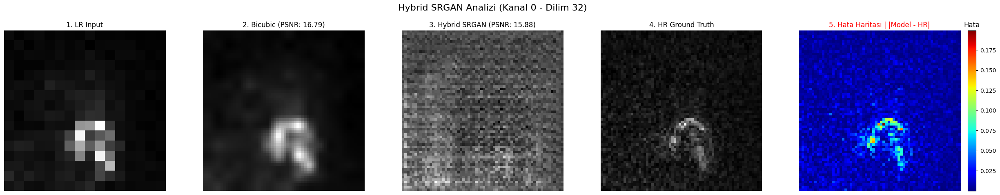

In [23]:
visualize_hybrid_output_improved(
    generator=generator,
    train_loader=train_loader,
    device=device,
    hr_key=HR_KEY,
    lr_key=LR_KEY,
    channel_idx=0   # T1 kanalı
)



## Modeli Kaydetme

In [ ]:
# Model ağırlıklarını kaydetme
checkpoint = {
    "generator_state_dict": generator.state_dict(),
    "discriminator_state_dict": discriminator.state_dict(),
    "optimizer_G_state_dict": optimizer_G.state_dict(),
    "optimizer_D_state_dict": optimizer_D.state_dict(),
    "epoch": num_epochs,
    # "loss_history": g_loss_history # İsteğe bağlı
}

torch.save(checkpoint, "/content/drive/MyDrive/srgan_qalas_checkpoint.pth")
print("Model ağırlıkları başarıyla kaydedildi.")

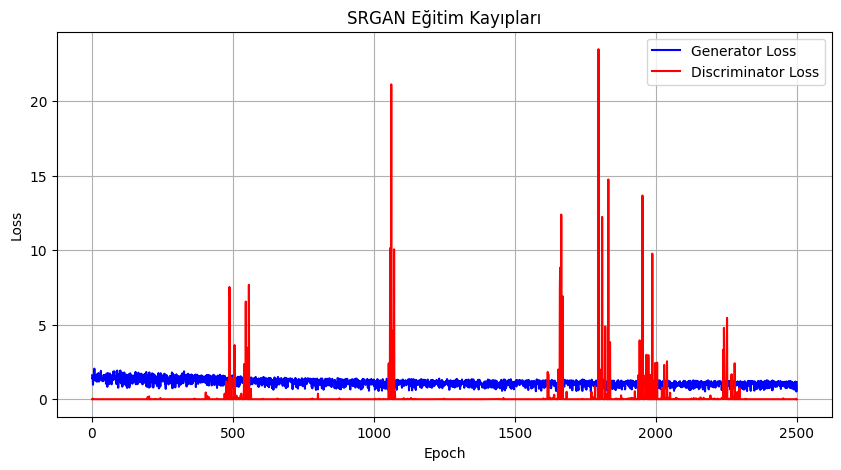

In [24]:
import matplotlib.pyplot as plt

# Epoch sayısı
epochs = range(1, num_epochs + 1)

plt.figure(figsize=(10,5))
plt.plot(epochs, g_loss_history, label='Generator Loss', color='blue')
plt.plot(epochs, d_loss_history, label='Discriminator Loss', color='red')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('SRGAN Eğitim Kayıpları')
plt.legend()
plt.grid(True)
plt.show()



--- Hybrid Model Metrik Sonuçları (Tüm Kanallar Ortalaması) ---
Model PSNR: 18.7320 | Bicubic PSNR: 19.8251
Model SSIM: 0.4952 | Bicubic SSIM: 0.5799
--------------------------------------------------


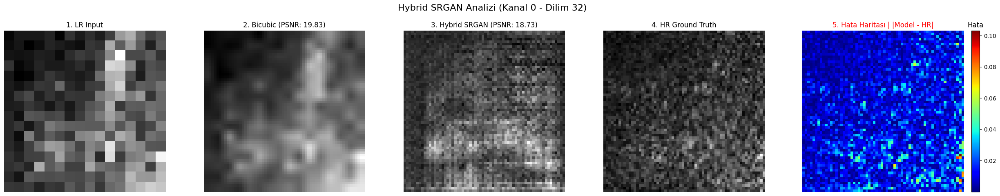

In [25]:
visualize_hybrid_output_improved(
    generator=generator,
    train_loader=train_loader,
    device=device,
    hr_key=HR_KEY,
    lr_key=LR_KEY,
    channel_idx=0   # T1 kanalı
)
